# <img style="float: left; padding: 0px 10px 0px 0px;" src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/84/Escudo_de_la_Pontificia_Universidad_Cat%C3%B3lica_de_Chile.svg/1920px-Escudo_de_la_Pontificia_Universidad_Cat%C3%B3lica_de_Chile.svg.png"  width="80" /> MCD3100 - Ciencia de Datos Geoespaciales
**Pontificia Universidad Católica de Chile**<br>
**Magister en Ciencia de Datos**<br>

<h2><center>Tarea 1: Análisis Espacial del Acceso a Agua Potable en Chile </center></h2>



<div class="alert alert-block alert-info">

## Instrucciones generales.


&#128236; **Entrega:** a través de Coursera, adjunte todos los archivos necesarios para ejecutar su código dentro de una única carpeta comprimida (.zip). Incluya el  Jupyter Notebook con el desarrollo (puede utilizar este mismo notebook), y las capas o archivos vectoriales que haya generado como parte de su análisis. El objetivo es que **el Notebook pueda correr completamente dentro de la carpeta entregada**. <br>

&#128013; La Tarea debe ser desarrollada en lenguaje de programación Python. <br>

&#11088; En el Notebook, incluya texto explicando los pasos u operaciones desarrolladas, no sólo el código. El objetivo es que el Notebook siga un hilo narrativo, sea claro y atractivo de leer. En [este link](https://github.com/brad-do/nb-miscellany/blob/master/things_to_do_in_markdown.ipynb) puede encontrar algunos tips útiles para usar celdas de anotaciones o Markdown. <br>


&#128519; El trabajo es **invididual**, y debe seguir todos los lineamientos de integridad académica del curso. Recuerde referenciar apropiadamente todas las referencias, códigos y datos consultados para el desarrollo de su tarea.<br>

</div>

## 1. Introducción: Acceso a Agua Potable en Chile.

La Agenda 2030 para el Desarrollo Sostenible es un acuerdo político histórico, firmado por 193 Estados Miembros de las Naciones Unidas en septiembre de 2015, que traza un marco para el desarrollo ambiental, social y económico. La agenda es aplicable a todos los países y personas, y está compuesta por 17 Objetivos de Desarrollo Sustentable (ODS) en materia e salud, educación e igualdad de género, entre otros [(Chile Agenda 2030)](https://www.chileagenda2030.gob.cl/).  En particular, el ODS Nº 6 pone el foco en **agua limpia y saneamiento**, y plantea **"garantizar la disponibilidad de agua y su gestión sostenible y el saneamiento para todos"**. A nivel mundial, existen miles de millones de personas (principalmente en áreas rurales) que aún carecen de estos servicios básicos; se estima por ejemplo que una de cada tres personas no tiene acceso a agua salubre y segura para el consumo humano.

En Chile, las zonas urbanas son abastecidas de agua por empresas sanitarias concesionadas, mientras que en localidades rurales, el suministro proviene de sistemas de agua potable rural (APR) implementados por el Ministerio de Obras Públicas (MOP). Si bien el sistema de saneamiento chileno destaca por sus altos índices de cobertura y calidad, existen aún brechas en cuanto a acceso universal y equitativo a agua potable. Por ejemplo, de acuerdo al diagnóstico realizado por el Ministerio de Desarrollo Social, el 7.8% de la población chilena (~1.520.000 personas) tiene un acceso deficiente a servicios básicos, porcentaje que aumenta a 36.3% si se consideran sólo las zonas rurales [(Data Social)](https://datasocial.ministeriodesarrollosocial.gob.cl/portalDataSocial/catalogoDimension/39).  En estas áreas, los programas de acceso son, en general, de bajo alcance y de alto costo, especialmente para aquellas comunidades rurales de menor número de familias ubicadas en zonas dispersas o semi-concentradas.


## 2. Análisis Espacial del Acceso a Agua Potable en Chile.

En esta Tarea, nos enfocaremos en analizar desde una perspectiva espacial la **distribución de población con acceso deficiente a agua potable en la región de Valparaíso, Chile**. El objetivo es localizar y cuantificar las viviendas y personas con acceso deficitario a agua potable, tanto en zonas urbanas como rurales, y generar visualizaciones cartográficas de dichos resultados.

En general, el agua potable para consumo humano puede obtenerse por alguno de los siguientes medios:

- Red pública de agua potable, administrada por una empresa sanitaria concesionada.
- Sistema de Agua Potable Rural (APR), en zonas rurales. Puede encontrar más información en este [link](https://www.mop.gob.cl/aguasrurales/) del Ministerio de Obras Públicas.
- Pozo o noria.
- Camión aljibe.
- Extracción directa de un río, vertiente, estero, canal, lago, etc.

Para efectos de este análisis, consideraremos que una vivienda tiene **acceso deficiente a agua potable** en las siguientes situaciones:

a) Vivienda en zona urbana fuera del territorio operacional de empresas sanitarias, y a más de 5 km de un APR.

b) Vivienda ubicada en una entidad rural dentro de la cual no existe APR.



## 3. Datos para la Tarea.

Para el análisis descrito anteriormente, se utilizarán los siguientes conjuntos de datos.

#### 3.1 Cartografía Censo 2017

http://www.censo2017.cl/servicio-de-mapas/

La cartografía censal incluye varias capas de utilidad para este análisis, como por ejemplo:

1. REGION_C17: límites regionales
2. COMUNA_C17: límites comunales
3. MANZANA_IND_C17: manzanas en zonas urbanas.
4. MANZANA_ALDEA_C17: manzanas en zonas rurales
5. ENTIDAD_C17: entidares rurales
6. LIMITE_URBANO_CENSAL_C17: límite de las zonas urbanas (dentro de la cual se encuentran las manzanas urbanas).

Las capas cartográficas del censo incluyen los datos del total de personas y viviendas en cada unidad territorial.

#### 3.2 Red de hidrográfica de Chile.

Capa con todos los ríos, vertientes, lagos y otras fuentes de agua en Chile: `datos_Tarea1/hidrografia/hidrografiaChile.gpkg`

#### 3.3 Sistemas de Agua Potable Rural (APR).

Ubicación de los sistemas de APR administrados por el MOP: `datos_Tarea1/APR/base_ssr.xlsx`.

Para efectos de este análisis, asumiremos que la información está actualizada, y que estos son los únicos APR existentes, aunque en realidad existen algunos otros financiados por SUBDERE.

*Nota 1:* el conjunto de datos publicado por el MOP en el Portal de Datos Abiertos del Gobierno de Chile (datos.gob.cl) está actualizado sólo hasta el año 2021. Esta situación refleja una falencia comúnmente encontrada en cuanto a disponibilidad de datos espaciales a nivel público y privado.

#### 3.4 Territorios operacionales de empresas sanitarias.

Zonas concesionada a empresas sanitarias de acuerdo a información publicada por la Superintendencia de Servicios Sanitarios (SISS):`datos_Tarea1/Territorio_operacional/TO_2022_V1.shp`

Corresponde al territorio cubierto por redes públicas de agua potable.

## 4. Desarrollo.

#### 4.1. Determine el porcentaje de áreas urbanas con servicio de agua potable entregado por una empresa sanitaria concesionada (**1 pt**) <br>

#### 4.2. Determine la cantidad de viviendas y personas habitantes de zonas urbanas con acceso deficiente a agua potable (de acuerdo a las definiciones del punto 2).(**1 pt**)<br>


#### 4.3. Determine la cantidad de viviendas y personas habitantes de zonas rurales con acceso deficiente a agua potable (de acuerdo a las definiciones del punto 2).(**2 pts**)<br>

#### 4.4. Para las entidades rurales sin APR, las alternativas de suministro son mediante camión aljibe o acceso directo a una fuente natural. Suponiendo que *toda la población de la entidad rural se concentra en su centroide*, calcule para cada una de ellas la distancia a la fuente de agua más cercana (estero, lago,  laguna, río, quebrada, embalse o tranque).(**2 pts**)<br>

#### 4.5. Suponga que una persona habitante de zona rural sin APR puede trasladarse un máximo de 1 km para ir a buscar agua, y de encontrarse a una distancia mayor de 1km, debe ser abastecido con camión aljibe. ¿A cuántas personas habría que abastecer mediante camión aljibe?(**1 pt**)<br>

#### 4.6. Genere un mapa con la ubicación de las entidades rurales que requieren suministro mediante camión aljibe, y la cantidad de personas a abastecer en cada una de ellas (como escala de colores).(**2 pts**)<br>




# Solucion

## 4.1. Determine el porcentaje de áreas urbanas con servicio de agua potable entregado por una empresa sanitaria concesionada (1 pt)

In [344]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely
import numpy as np
import contextily as ctx
import seaborn as sns
crs='3857'
crs=32719

In [2]:
region_val = gpd.read_file('datos_Tarea1/censo/R05/REGION_C17.shp').to_crs(crs)
print(region_val.crs)
region_val

EPSG:32719


,REGION,NOM_REGION,SHAPE_Leng,SHAPE_Area,geometry
0,5,REGIÓN DE VALPARAÍSO,13.208477,1.561799,"MULTIPOLYGON (((-595584.168 6196464.132, -5955..."


In [3]:
zona_urbana = gpd.read_file('datos_Tarea1/censo/R05/LIMITE_URBANO_CENSAL_C17.shp').to_crs(crs)
print(zona_urbana.crs)
zona_urbana

EPSG:32719


,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,TIPO,NOM_CATEG,SHAPE_Leng,SHAPE_Area,geometry
0,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5602,ALGARROBO,MIRASOL - EL YECO,URBANO,CIUDAD,0.163266,0.000494,"POLYGON ((253135.207 6311912.504, 253138.124 6..."
1,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5602,ALGARROBO,ALGARROBO,CAPITAL COMUNAL,CIUDAD,0.249353,0.001116,"POLYGON ((253388.298 6307319.566, 253437.986 6..."
2,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5604,EL QUISCO,EL QUISCO,CAPITAL COMUNAL,CIUDAD,0.339432,0.001462,"POLYGON ((249737.594 6304198.587, 249779.521 6..."
3,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5502,CALERA,LA CALERA,CAPITAL COMUNAL,CIUDAD,0.171591,0.001259,"POLYGON ((294508.851 6372627.07, 294509.231 63..."
4,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5503,HIJUELAS,HIJUELAS,CAPITAL COMUNAL,CIUDAD,0.257747,0.000877,"POLYGON ((298131.953 6370383.811, 298135.21 63..."
...,...,...,...,...,...,...,...,...,...,...,...,...
59,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5601,SAN ANTONIO,SAN ANTONIO,CAPITAL PROVINCIAL,CIUDAD,0.470603,0.002168,"POLYGON ((256096.247 6284436.44, 256100.533 62..."
60,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,LAGUNA VERDE,URBANO,PUEBLO,0.247053,0.001351,"POLYGON ((251601.795 6335262.555, 251604.347 6..."
61,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,VALPARAÍSO,CAPITAL REGIONAL,CIUDAD,0.430605,0.004629,"POLYGON ((253497.59 6343601.61, 253497.583 634..."
62,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,PLACILLA DE PEÑUELAS,URBANO,CIUDAD,0.238372,0.001507,"POLYGON ((260020.377 6334182.424, 260014.777 6..."


In [4]:
cobertura_empresa = gpd.read_file('datos_Tarea1/Territorio_operacional/TO_2022_V1.shp').to_crs(crs)
cobertura_empresa['flag_servicio_empresa'] = 1
print(cobertura_empresa.crs)

# algunas zonas de cobertura se traslapan
total_geom = cobertura_empresa.geometry.union_all()
zona_cobertura = gpd.GeoDataFrame({"name": ["total_coverage"]},
                             geometry=[total_geom],
                             crs=cobertura_empresa.crs)

# el area del poligono resultante deberia ser menor, pues la idea es que areas con multiples coberturas no se cuenten dos veces

cobertura_inicial = cobertura_empresa.area.sum()/1e6
cobertura_final = zona_cobertura.area[0]/1e6

assert cobertura_final <= cobertura_inicial

print(f"Se paso de cubrir {np.round(cobertura_inicial,2)} a {np.round(cobertura_final,2)} km2")

EPSG:32719
Se paso de cubrir 3047.16 a 3043.05 km2


In [5]:
cobertura_empresa

,OBJECTID,COD_LOC,LOCALIDAD,ID_TO,DEM_TO,CODIGO_REG,NOMBRE_REG,RUT_EMPRES,NOMBRE_EMP,CODIGO_SIS,NOMBRE_SIS,CODIGO_LOC,NOMBRE_LOC,geometry,flag_servicio_empresa
0,5,1.0,ACHAO,1.0,ACHAO,10,REGION DE LOS LAGOS,96579800,ESSAL S.A.,104,ACHAO,1,ACHAO,"POLYGON ((130053.446 5288495.335, 130617.774 5...",1
1,6,3.0,AGUAS COLINA,2.0,AGUAS COLINA,13,REGION METROPOLITANA,96770130,AGUAS DE COLINA S.A.,262,AGUAS COLINA,3,AGUAS COLINA,"POLYGON ((336910.798 6321867.445, 336912.36 63...",1
2,7,4.0,AGUAS CORDILLERA,351.0,VITACURA - LO BARNECHEA - LAS CONDES,13,REGION METROPOLITANA,96809310,AGUAS CORDILLERA S.A.,57,AGUAS CORDILLERA,4,AGUAS CORDILLERA,"MULTIPOLYGON (((351276.474 6302036.507, 351295...",1
3,8,5.0,LAS LILAS,3.0,AGUAS DE LAS LILAS,13,REGION METROPOLITANA,96855310,AGUAS DE LAS LILAS S.A.,263,AGUAS DE LAS LILAS,5,LAS LILAS,"POLYGON ((329835.617 6304510.589, 330257.617 6...",1
4,9,6.0,AGUAS LA SERENA,4.0,AGUAS LA SERENA,4,REGION DE COQUIMBO,96684710,AGUAS LA SERENA S.A.,264,AGUAS LA SERENA,6,AGUAS LA SERENA,"POLYGON ((280267.881 6692913.682, 280258.184 6...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
378,420,396.0,HACIENDO BATUCO,356.0,HACIENDA BATUCO,13,REGION METROPOLITANA,76115834,AGUAS SANTIAGO NORTE S.A.,318,HACIENDA BATUCO,396,HACIENDA BATUCO,"MULTIPOLYGON (((332963.96 6320852.25, 332975.1...",1
379,421,397.0,PANITAO,363.0,PANITAO,10,REGION DE LOS LAGOS,96889730,EMPRESA DE SERVICIOS SANITARIOS SAN ISIDRO S.A.,324,PANITAO,397,PANITAO,"POLYGON ((162878.124 5393786.503, 162881.542 5...",1
380,2,138.0,LA PUNTA,145.0,LA PUNTA,6,REGION DEL LIBERTADOR B. OHIGGINS,76833300,ESSBIO S.A.,139,CODEGUA - LA PUNTA,138,LA PUNTA,"MULTIPOLYGON (((348502.896 6234376.446, 348488...",1
381,3,0.0,MAINTENCILLO,0.0,None,0,None,0,None,0,None,0,MAINTENCILLO,"POLYGON ((273055 6386732, 273015 6386630, 2729...",1


In [6]:
cobertura_empresa['area'] = cobertura_empresa.area
cobertura_empresa.groupby('DEM_TO')['area'].sum().sort_values()

DEM_TO
JARDINES DE LA ESTACION    3.140508e+04
BAQUEDANO                  1.012828e+05
LA HUAYCA                  1.043024e+05
PISAGUA                    1.418721e+05
MATILLA                    1.434464e+05
                               ...     
MAIPU                      7.688992e+07
IQUIQUE                    8.689265e+07
GRAN VALPARAISO            1.654643e+08
ISLA DE PASCUA             2.477981e+08
GRAN SANTIAGO              5.274581e+08
Name: area, Length: 362, dtype: float64

In [7]:
zona_urbana['NOM_REGION'].value_counts()

NOM_REGION
REGIÓN DE VALPARAÍSO    64
Name: count, dtype: int64

In [8]:
zona_urbana['area'] = zona_urbana.area
zona_urbana.groupby('NOM_PROVIN')['area'].sum().sort_values()

NOM_PROVIN
ISLA DE PASCUA             1.907101e+07
LOS ANDES                  2.796109e+07
PETORCA                    3.744985e+07
SAN FELIPE DE ACONCAGUA    4.677556e+07
QUILLOTA                   5.735703e+07
SAN ANTONIO                9.615887e+07
MARGA MARGA                9.951639e+07
VALPARAÍSO                 2.670474e+08
Name: area, dtype: float64

In [9]:
#zona_urbana = zona_urbana.loc[zona_urbana['NOM_PROVIN']!='ISLA DE PASCUA']
region_val_urb = zona_urbana.overlay(region_val)

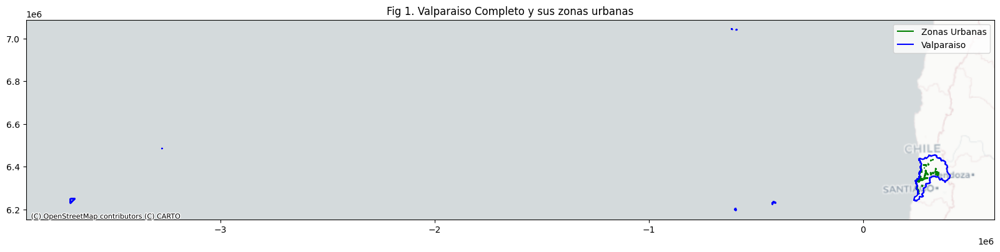

In [10]:
fig, axis = plt.subplots(figsize=(20,20))

zona_urbana.to_crs(crs).boundary.plot(color='green',ax=axis, label='Zonas Urbanas')
region_val.to_crs(crs).boundary.plot(color='blue',ax=axis, label='Valparaiso')
ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 1. Valparaiso Completo y sus zonas urbanas')
axis.legend()
plt.show()

In [11]:
zona_urbana_cubierta = zona_urbana.overlay(zona_cobertura)

area_zona_urbana = zona_urbana.area.sum()
area_zona_urbana_cubierta = zona_urbana_cubierta.area.sum()

numero_zonas_urbanas = len(zona_urbana)
numero_zonas_urbanas_cubiertas = len(zona_urbana_cubierta)

area_zona_urbana_cubierta_porcentaje = round((area_zona_urbana_cubierta/area_zona_urbana)*100,2)
numero_zona_urbana_cubierta_porcentaje = round((numero_zonas_urbanas_cubiertas/numero_zonas_urbanas)*100,2)

print("Punto de Vista de área cubierta (kilómetros cuadrados)")
print(f'Área en Kilómetros Cuadrados de la Zona Urbana TOTAL de Valparaiso: {round(area_zona_urbana/1e6,2)}')
print(f'Área en Kilómetros Cuadrados de la Zona Urbana TOTAL de Valparaiso cubierta por Empresas Sanitarias Concesionadas: {round(area_zona_urbana_cubierta/1e6,2)}')

print(f'Porcentaje de zona urbana de Valparaíso con servicio de Empresas Sanitarias Concesionadas: {area_zona_urbana_cubierta_porcentaje}%')

print("Punto de Vista de Provincias (Número de provincias con presencia de servicio)")

print(f'Provincias de Valparaiso: {round(numero_zonas_urbanas,2)}')
print(f'Provincias con Zona Urbana de Valparaiso cubierta por Empresas Sanitarias Concesionadas: {round(numero_zonas_urbanas_cubiertas,2)}')

print(f'Porcentaje de zona urbana de Valparaíso con servicio de Empresas Sanitarias Concesionadas: {numero_zona_urbana_cubierta_porcentaje}%')

Punto de Vista de área cubierta (kilómetros cuadrados)
Área en Kilómetros Cuadrados de la Zona Urbana TOTAL de Valparaiso: 651.34
Área en Kilómetros Cuadrados de la Zona Urbana TOTAL de Valparaiso cubierta por Empresas Sanitarias Concesionadas: 332.53
Porcentaje de zona urbana de Valparaíso con servicio de Empresas Sanitarias Concesionadas: 51.05%
Punto de Vista de Provincias (Número de provincias con presencia de servicio)
Provincias de Valparaiso: 64
Provincias con Zona Urbana de Valparaiso cubierta por Empresas Sanitarias Concesionadas: 51
Porcentaje de zona urbana de Valparaíso con servicio de Empresas Sanitarias Concesionadas: 79.69%


### Respuesta
Las empresas sanitarias concesionadas sirven en un 51% de la zona urbana de Valparaíso desde el punto de vista de territorio cubierto (Kilómetros cuadrados).

Si vemos el número de provincias, el porcentaje de estas que, por lo menos, tienen presencia de servicio sanitario por parte de empresas es del 80%.

## 4.2 Determine la cantidad de viviendas y personas habitantes de zonas urbanas con acceso deficiente a agua potable (de acuerdo a las definiciones del punto 2).(1 pt)

In [12]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely
import numpy as np
import contextily as ctx

crs='3857'
crs=32719

In [82]:
manz_urb = gpd.read_file('datos_Tarea1/censo/R05/MANZANA_IND_C17.shp').to_crs(crs)
manz_urb['area'] = manz_urb.area
manz_urb = manz_urb.loc[manz_urb['NOM_PROVIN']!='ISLA DE PASCUA',:]
print(manz_urb['NOM_REGION'].unique())
manz_urb

['REGIÓN DE VALPARAÍSO']


,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,11,1,CD,5101211004011,9,5,0.030157,2.749026e-05,"POLYGON ((259458.63 6333368.59, 259458.41 6333...",284754.255015
1,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,7,1,CD,5101211004007,87,30,0.004327,1.204902e-06,"POLYGON ((259992.21 6333848.61, 259991.83 6333...",12480.945379
2,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,6,1,CD,5101211004006,78,23,0.005661,1.200424e-06,"POLYGON ((260066.72 6333944.18, 260087.405 633...",12434.503481
3,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,4,1,CD,5101211004004,43,14,0.005446,7.328933e-07,"POLYGON ((260352.849 6333889.905, 260349.234 6...",7591.600449
4,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,8,5,1,CD,5101211008005,19,12,0.037420,2.312158e-05,"POLYGON ((261268.394 6333892.585, 261264.351 6...",239497.367646
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20012,5,REGIÓN DE VALPARAÍSO,57,SAN FELIPE DE ACONCAGUA,5702,CATEMU,6,1,4,1,CD,5702061001004,19,8,0.005331,5.600051e-07,"POLYGON ((316265.232 6368152.423, 316266.715 6...",5816.528264
20013,5,REGIÓN DE VALPARAÍSO,57,SAN FELIPE DE ACONCAGUA,5702,CATEMU,1,1,901,1,CD,5702011001901,68,26,0.094423,2.841501e-05,"MULTIPOLYGON (((316379.48 6371052.09, 316375.0...",295243.302609
20014,5,REGIÓN DE VALPARAÍSO,57,SAN FELIPE DE ACONCAGUA,5702,CATEMU,6,1,901,1,CD,5702061001901,26,9,0.013150,4.531779e-06,"MULTIPOLYGON (((316385.74 6368142.01, 316386 6...",47073.710281
20015,5,REGIÓN DE VALPARAÍSO,54,PETORCA,5401,LA LIGUA,2,4,901,1,CD,5401021004901,20,9,0.031083,1.950277e-05,"MULTIPOLYGON (((288937.621 6406578.124, 288981...",203418.969578


In [83]:
cobertura_empresa = gpd.read_file('datos_Tarea1/Territorio_operacional/TO_2022_V1.shp').to_crs(crs)
cobertura_empresa['area'] = cobertura_empresa.area
display(cobertura_empresa.head(10))
# obtenemos solo valpariso
cobertura_empresa = cobertura_empresa.loc[cobertura_empresa['NOMBRE_REG']=='REGION DE VALPARAISO',:]

# para validar que se haga el calculo correcto, filtramos solo valparaiso tierra (sin islas) para facilitar viz
# al terminar el ejercio, tengo que comentar la siguiente linea
cobertura_empresa = cobertura_empresa.loc[cobertura_empresa['LOCALIDAD']!='HANGA ROA',:]


print(cobertura_empresa.crs)

# algunas zonas de cobertura se traslapan
total_geom = cobertura_empresa.geometry.union_all()
zona_cobertura = gpd.GeoDataFrame({"name": ["total_coverage"]},
                             geometry=[total_geom],
                             crs=cobertura_empresa.crs)

# el area del poligono resultante deberia ser menor, pues la idea es que areas con multiples coberturas no se cuenten dos veces

cobertura_inicial = cobertura_empresa.area.sum()/1e6
cobertura_final = zona_cobertura.area[0]/1e6

assert cobertura_final <= cobertura_inicial

print(f"Se paso de cubrir {np.round(cobertura_inicial,2)} a {np.round(cobertura_final,2)} km2")

,OBJECTID,COD_LOC,LOCALIDAD,ID_TO,DEM_TO,CODIGO_REG,NOMBRE_REG,RUT_EMPRES,NOMBRE_EMP,CODIGO_SIS,NOMBRE_SIS,CODIGO_LOC,NOMBRE_LOC,geometry,area
0,5,1.0,ACHAO,1.0,ACHAO,10,REGION DE LOS LAGOS,96579800,ESSAL S.A.,104,ACHAO,1,ACHAO,"POLYGON ((130053.446 5288495.335, 130617.774 5...",8.269936e+05
1,6,3.0,AGUAS COLINA,2.0,AGUAS COLINA,13,REGION METROPOLITANA,96770130,AGUAS DE COLINA S.A.,262,AGUAS COLINA,3,AGUAS COLINA,"POLYGON ((336910.798 6321867.445, 336912.36 63...",1.832368e+07
2,7,4.0,AGUAS CORDILLERA,351.0,VITACURA - LO BARNECHEA - LAS CONDES,13,REGION METROPOLITANA,96809310,AGUAS CORDILLERA S.A.,57,AGUAS CORDILLERA,4,AGUAS CORDILLERA,"MULTIPOLYGON (((351276.474 6302036.507, 351295...",7.162006e+07
3,8,5.0,LAS LILAS,3.0,AGUAS DE LAS LILAS,13,REGION METROPOLITANA,96855310,AGUAS DE LAS LILAS S.A.,263,AGUAS DE LAS LILAS,5,LAS LILAS,"POLYGON ((329835.617 6304510.589, 330257.617 6...",3.799881e+06
4,9,6.0,AGUAS LA SERENA,4.0,AGUAS LA SERENA,4,REGION DE COQUIMBO,96684710,AGUAS LA SERENA S.A.,264,AGUAS LA SERENA,6,AGUAS LA SERENA,"POLYGON ((280267.881 6692913.682, 280258.184 6...",4.645407e+06
5,10,7.0,PARQUE INDUSTRIAL CORONEL,224.0,PARQUE INDUSTRIAL CORONEL,8,REGION DEL BIOBIO,99593190,AGUAS SAN PEDRO S.A.,302,PARQUE INDUSTRIAL CORONEL,7,PARQUE INDUSTRIAL CORONEL,"MULTIPOLYGON (((131308 5897775, 131442 5897567...",3.763955e+07
6,11,8.0,SARMIENTO,321.0,SARMIENTO,7,REGION DEL MAULE,70240900,COOP. DE SERVICIO DE ABASTECIMIENTO DE AP Y SA...,275,COOPERATIVA SARMIENTO,8,SARMIENTO,"POLYGON ((300038 6132753, 300003 6132601, 2998...",2.139624e+06
7,12,9.0,ALERCE,6.0,ALERCE,10,REGION DE LOS LAGOS,96579800,ESSAL S.A.,105,ALERCE,9,ALERCE,"MULTIPOLYGON (((174732.262 5409527.301, 175032...",8.623135e+06
8,13,10.0,ALGARROBO,8.0,ALGARROBO,5,REGION DE VALPARAISO,76000739,ESVAL S.A.,230,LITORAL SUR,10,ALGARROBO,"MULTIPOLYGON (((254418.331 6306213.36, 254438....",1.115183e+07
9,14,11.0,ALGARROBO NORTE,9.0,ALGARROBO NORTE,5,REGION DE VALPARAISO,76000739,ESVAL S.A.,266,ALGARROBO NORTE,11,ALGARROBO NORTE,"POLYGON ((253583.519 6308381.508, 253212.162 6...",2.854839e+05


EPSG:32719
Se paso de cubrir 386.8 a 385.8 km2


In [84]:
cobertura_empresa.groupby('LOCALIDAD')['area'].sum()

LOCALIDAD
ALGARROBO                 1.115183e+07
ALGARROBO NORTE           2.854839e+05
ALMENDRAL                 2.750267e+06
ARTIFICIO                 3.501338e+06
CABILDO                   2.451635e+06
CACHAGUA                  1.829078e+06
CALLE LARGA               8.250521e+06
CARTAGENA                 4.479354e+06
CASABLANCA                3.886505e+06
CATEMU                    1.492685e+06
CHEPICAL                  1.077770e+06
CHINCOLCO                 1.965041e+06
CONCON                    1.150171e+07
CURAUMA                   8.423816e+06
EL ALTO                   2.406219e+06
EL QUISCO                 8.897844e+06
EL TABO                   4.798198e+06
FRANJA COSTERA            1.903243e+06
HIJUELAS                  2.795272e+06
ISLA NEGRA                1.397508e+06
LA CALERA                 6.847810e+06
LA CRUZ                   3.873610e+06
LA LAGUNA                 1.516256e+06
LA LIGUA                  4.261791e+06
LAS BRISAS DE MIRASOL     9.688235e+05
LAS CRUCES     

In [85]:
cobertura_empresa['NOMBRE_LOC'].unique()

array(['ALGARROBO', 'ALGARROBO NORTE', 'ALMENDRAL', 'ARTIFICIO',
       'CABILDO', 'CACHAGUA', 'CALLE LARGA', 'CARTAGENA', 'CASABLANCA',
       'CATEMU', 'CHEPICAL', 'CHINCOLCO', 'CONCON', 'CURAUMA',
       'EL QUISCO', 'EL TABO', 'HIJUELAS', 'ISLA NEGRA', 'LA CALERA',
       'LA CRUZ', 'LA LAGUNA', 'LA LIGUA', 'LAS BRISAS DE MIRASOL',
       'LAS CRUCES', 'LIMACHE', 'LLAY LLAY', 'LOS ANDES', 'LOS MOLLES',
       'MIRASOL ALGARROBO', 'NOGALES', 'PAPUDO', 'PETORCA',
       'PLACILLA DE LA LIGUA', 'PLACILLA DE PEÃ\x91UELAS', 'PUCHUNCAVI',
       'PUNTA DE TRALCA', 'PUTAENDO', 'QUILLOTA', 'QUILPUE', 'QUINTERO',
       'REAL CURIMON', 'RINCONADA', 'ROCAS DE SANTO DOMINGO',
       'SAN ANTONIO', 'SAN ESTEBAN', 'SAN FELIPE', 'SAN PEDRO',
       'SAN SEBASTIAN', 'SANTA MARIA', 'VALPARAISO', 'VILLA ALEMANA',
       'VIÃ\x91A DEL MAR', 'ZAPALLAR', 'FRANJA COSTERA', 'RODELILLO',
       'EL ALTO'], dtype=object)

In [86]:
apr = pd.read_excel('datos_Tarea1/APR/base_ssr.xlsx', header=2)
apr = apr.drop(columns=['Unnamed: 0'])
apr = apr.loc[apr['Región']=='Valparaíso', :]

geometry_apr = gpd.points_from_xy(
    apr['Coord X WGS84'],
    apr['Coord Y WGS84 ']
)

geometry_apr

apr = gpd.GeoDataFrame(
    data=apr,
    geometry=geometry_apr,
    crs='EPSG:32719'
)
apr = apr.loc[~((apr['geometry'].x == 0) & (apr['geometry'].y == 0)), :]
apr

,N°,Región,Provincia,Comuna,Nombre oficial sistema,año puesta en marcha,N° de Arranques a diciembre 2020,Tipo,Fondos,"Beneficiarios/as Estimados a dic 2020\n 3,10 Benef/arr",...,Situación,Nombre fantasía 1,Coord X WGS84,Coord Y WGS84,Huso,Coord X WGS84 H19 Este,Coord Y WGS84 H19 norte,Coord X grados,Coord Y grados,geometry
325,279,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL EL PIMIENTO,1981.0,109.0,CONCENTRADO,BID III,338.0,...,Activo,EL PIMIENTO,351740.0,6361730.0,19.0,351740.0,6361730.0,-70.584739,-32.872541,POINT (351740 6361730)
326,314,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL LAS CALDERAS,1989.0,689.0,CONCENTRADO,BID IV,2136.0,...,Activo,LAS CALDERAS,351160.0,6360072.0,19.0,351160.0,6360072.0,-70.591203,-32.887412,POINT (351160 6360072)
327,281,Valparaíso,Los Andes,Los Andes,COMITE AGUA POTABLE RURAL EL SAUCE,1991.0,580.0,CONCENTRADO,F. MOP,1798.0,...,Activo,EL SAUCE,355460.0,6365720.0,19.0,355460.0,6365720.0,-70.544365,-32.837059,POINT (355460 6365720)
328,378,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL RIECILLO,1999.0,45.0,CONCENTRADO,ISAR MOP,140.0,...,Activo,RIECILLO,373239.0,6355995.0,19.0,373239.0,6355995.0,-70.355786,-32.926959,POINT (373239 6355995)
329,380,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL DE RIO BLANCO,1994.0,328.0,CONCENTRADO,F. MOP,1017.0,...,Activo,RÍO BLANCO,378087.0,6358009.0,19.0,378087.0,6358009.0,-70.303679,-32.909348,POINT (378087 6358009)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,275,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Renacer,2004.0,261.0,CONCENTRADO,FNDR,809.0,...,Activo,EL MIRADOR-SANTA ADELA (RENACER),266860.0,6359390.0,19.0,266860.0,6359390.0,-71.491997,-32.878852,POINT (266860 6359390)
517,351,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Mantagua,1998.0,148.0,CONCENTRADO,ISAR MOP,459.0,...,Activo,MANTAGUA,268280.0,6360690.0,19.0,268280.0,6360690.0,-71.476505,-32.867438,POINT (268280 6360690)
518,390,Valparaíso,Valparaíso,Quintero,Comite Agua Potable Rural Santa Julia,2004.0,107.0,CONCENTRADO,FNDR,332.0,...,Activo,SANTA JULIA,268415.0,6364190.0,19.0,268415.0,6364190.0,-71.474187,-32.835924,POINT (268415 6364190)
519,400,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Valle Alegre,1984.0,150.0,CONCENTRADO,BID III,465.0,...,Activo,VALLE ALEGRE,272162.0,6366995.0,19.0,272162.0,6366995.0,-71.433497,-32.811429,POINT (272162 6366995)


In [87]:
apr['geometry']

325    POINT (351740 6361730)
326    POINT (351160 6360072)
327    POINT (355460 6365720)
328    POINT (373239 6355995)
329    POINT (378087 6358009)
                ...          
516    POINT (266860 6359390)
517    POINT (268280 6360690)
518    POINT (268415 6364190)
519    POINT (272162 6366995)
520    POINT (251160 6333410)
Name: geometry, Length: 166, dtype: geometry

In [88]:
apr['Región'].value_counts()

Región
Valparaíso    166
Name: count, dtype: int64

<Axes: >

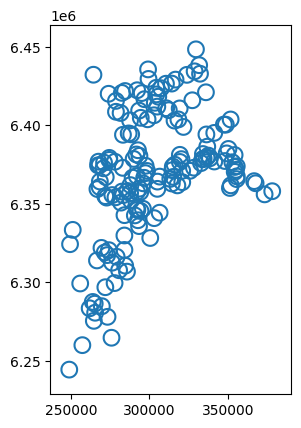

In [89]:
buf_apr=apr.buffer(5000)
buf_apr.boundary.plot()

C:\Users\Erick\AppData\Local\Temp\ipykernel_12932\4106430900.py:10: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  axis.legend()


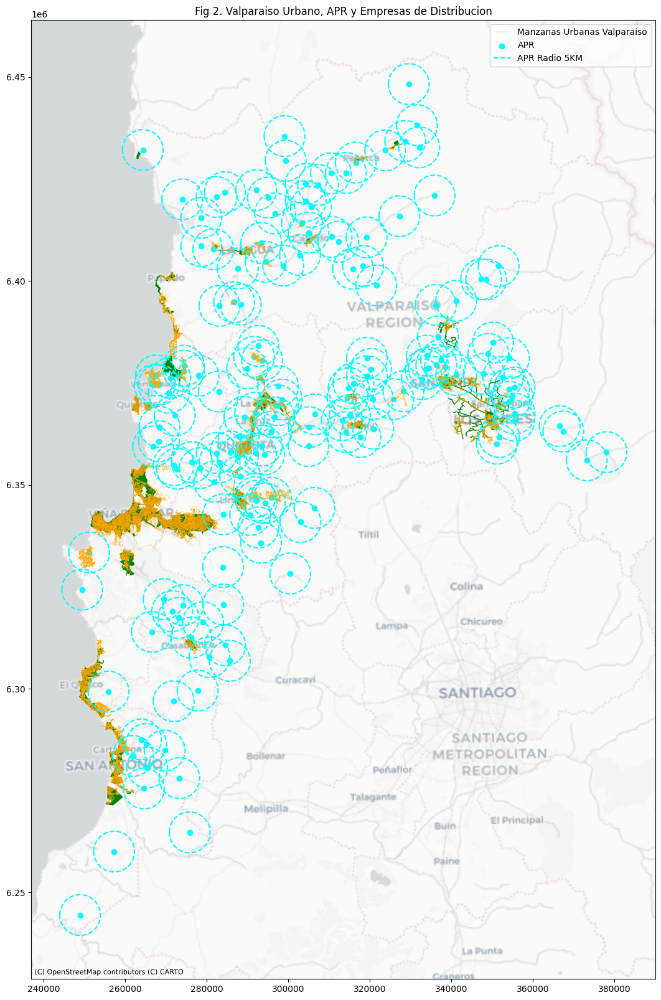

In [90]:
fig, axis = plt.subplots(figsize=(20, 20))

manz_urb.boundary.plot(ax=axis, label='Manzanas Urbanas Valparaíso', color='orange', lw=0.2)
zona_cobertura.plot(ax=axis, label='Zona de Cobertura Empresas Sanitarias', color='green')
apr.plot(ax=axis, label='APR', color='aqua')
buf_apr.boundary.plot(ax=axis, label='APR Radio 5KM', color='aqua', linestyle='--')

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 2. Valparaiso Urbano, APR y Empresas de Distribucion')
axis.legend()
plt.show()

In [91]:
acceso_agua = gpd.GeoSeries([gpd.GeoSeries(
    [zona_cobertura.geometry.union_all(), buf_apr.geometry.union_all()],
    crs=crs
).union_all()], crs=crs)

acceso_agua

0    MULTIPOLYGON (((250401.423 6239695.298, 249925...
dtype: geometry

C:\Users\Erick\AppData\Local\Temp\ipykernel_12932\3570542879.py:7: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  axis.legend()


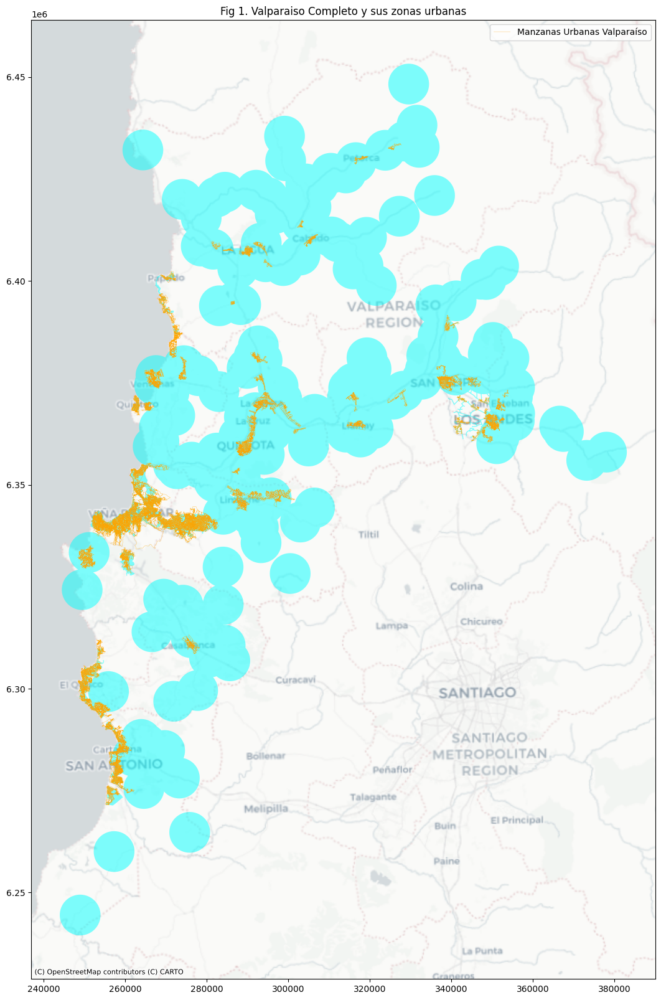

In [93]:
fig, axis = plt.subplots(figsize=(20, 20))

acceso_agua.plot(ax=axis, label='Tiene Acceso a Agua', color='aqua', alpha=0.5, linestyle='--')
manz_urb.boundary.plot(ax=axis, label='Manzanas Urbanas Valparaíso', color='orange', lw=0.2)

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 3. Valparaiso Completo y sus zonas urbanas')
axis.legend()
plt.show()

In [94]:
manz_urb_acceso = manz_urb.clip(acceso_agua)

In [95]:
manz_urb_acceso

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
14634,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5606,SANTO DOMINGO,1,3,508,1,CD,5606011003508,531,217,0.039711,1.208658e-05,"POLYGON ((257998.061 6274289.926, 257998.374 6...",124442.544126
14642,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5606,SANTO DOMINGO,1,3,504,1,CD,5606011003504,22,12,0.002412,2.698596e-07,"POLYGON ((258275.037 6274118.5, 258272.456 627...",2778.464071
14607,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5606,SANTO DOMINGO,1,3,42,1,CD,5606011003042,71,23,0.002231,2.994328e-07,"POLYGON ((258105.885 6274120.425, 258072.97 62...",3082.959999
14643,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5606,SANTO DOMINGO,1,3,505,1,CD,5606011003505,37,17,0.002729,3.385471e-07,"POLYGON ((258319.374 6274140.412, 258317.914 6...",3485.678847
14596,5,REGIÓN DE VALPARAÍSO,56,SAN ANTONIO,5606,SANTO DOMINGO,1,3,44,1,CD,5606011003044,99,32,0.002934,4.719541e-07,"POLYGON ((258211.339 6274143.281, 258207.771 6...",4859.248138
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9697,5,REGIÓN DE VALPARAÍSO,54,PETORCA,5404,PETORCA,4,1,6,2,PB,5404041001006,22,14,0.011224,3.994901e-06,"POLYGON ((325596.407 6432960.655, 325627.805 6...",41754.962893
9565,5,REGIÓN DE VALPARAÍSO,54,PETORCA,5404,PETORCA,4,1,7,2,PB,5404041001007,27,17,0.020308,1.865860e-05,"POLYGON ((325630.397 6432916.424, 325601.78 64...",195024.393864
9567,5,REGIÓN DE VALPARAÍSO,54,PETORCA,5404,PETORCA,4,1,12,2,PB,5404041001012,60,26,0.022354,1.353115e-05,"POLYGON ((327645 6433468.408, 327658.096 64334...",141432.438138
9566,5,REGIÓN DE VALPARAÍSO,54,PETORCA,5404,PETORCA,4,1,10,2,PB,5404041001010,30,16,0.015383,7.618765e-06,"POLYGON ((326595.152 6433558.499, 326604.246 6...",79635.107937


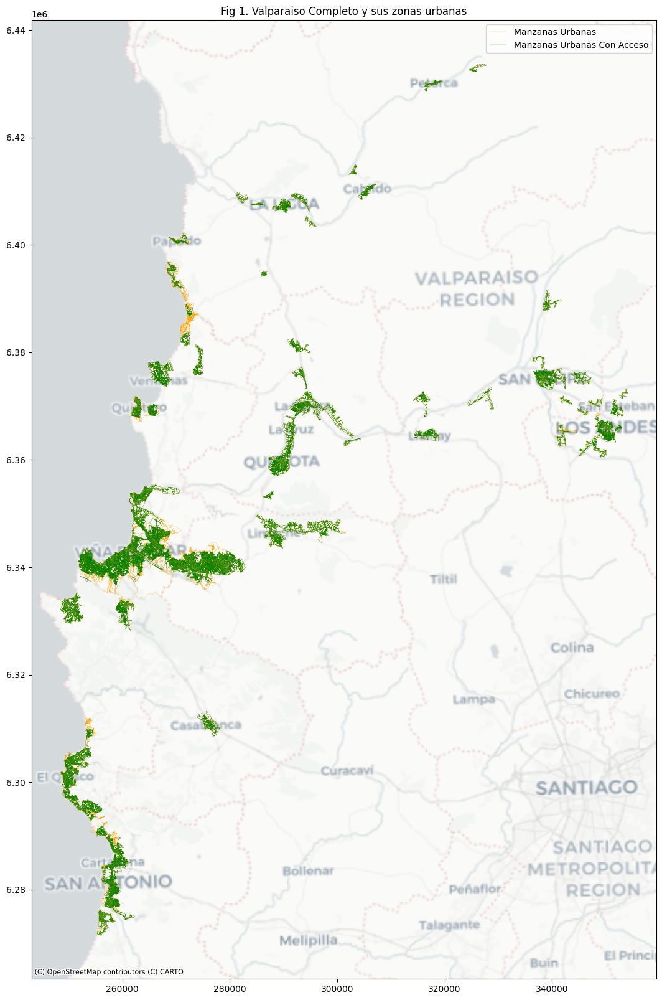

In [96]:
fig, axis = plt.subplots(figsize=(20, 20))

manz_urb.boundary.plot(ax=axis, label='Manzanas Urbanas', color='orange', lw=0.2)
manz_urb_acceso.boundary.plot(ax=axis, label='Manzanas Urbanas Con Acceso', color='green', lw=0.2)

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 4. Valparaiso Completo y sus zonas urbanas')
axis.legend()
plt.show()

In [97]:
# Para hacer el calculo de la cantidad de viviendas y personas habitantes de zonas urbanas con acceso deficiente a agua potable
# se va a calcular:
# 1. Cantidad de viviendas y personas en zona urbana total de Valparaiso
# 2. Cantidad de viviendas y personas en zona urbana con acceso a agua potable
# 3. La cantidad de personas con acceso deficiente sera el resultado del punto 1 menos el resultado del punto 2

display(manz_urb.head())

viv_urb_total = sum(manz_urb['TOTAL_VIVI'])
per_urb_total = sum(manz_urb['TOTAL_PERS'])

print(viv_urb_total, per_urb_total)

viv_urb_total_con_acceso = sum(manz_urb_acceso['TOTAL_VIVI'])
per_urb_total_con_acceso = sum(manz_urb_acceso['TOTAL_PERS'])

print(viv_urb_total_con_acceso, per_urb_total_con_acceso)


viv_urb_sin_acceso = viv_urb_total - viv_urb_total_con_acceso
per_urb_sin_acceso = per_urb_total - per_urb_total_con_acceso

print(f'Viviendas con acceso deficiente a agua potable: {viv_urb_sin_acceso}')
print(f'Personas con acceso deficiente a agua potable: {per_urb_sin_acceso}')

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,11,1,CD,5101211004011,9,5,0.030157,2.749026e-05,"POLYGON ((259458.63 6333368.59, 259458.41 6333...",284754.255015
1,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,7,1,CD,5101211004007,87,30,0.004327,1.204902e-06,"POLYGON ((259992.21 6333848.61, 259991.83 6333...",12480.945379
2,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,6,1,CD,5101211004006,78,23,0.005661,1.200424e-06,"POLYGON ((260066.72 6333944.18, 260087.405 633...",12434.503481
3,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,4,4,1,CD,5101211004004,43,14,0.005446,7.328933e-07,"POLYGON ((260352.849 6333889.905, 260349.234 6...",7591.600449
4,5,REGIÓN DE VALPARAÍSO,51,VALPARAÍSO,5101,VALPARAÍSO,21,8,5,1,CD,5101211008005,19,12,0.037420,2.312158e-05,"POLYGON ((261268.394 6333892.585, 261264.351 6...",239497.367646


703844 1635345
695687 1620291
Viviendas con acceso deficiente a agua potable: 8157
Personas con acceso deficiente a agua potable: 15054


### Respuesta

Viviendas con acceso deficiente a agua potable: 8,157

Personas con acceso deficiente a agua potable: 15,054

## 4.3 Determine la cantidad de viviendas y personas habitantes de zonas rurales con acceso deficiente a agua potable (de acuerdo a las definiciones del punto 2).(2 pts)

In [133]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely
import numpy as np
import contextily as ctx

crs='3857'
crs=32719

In [205]:
# Zonas Rurales

manz_rur = gpd.read_file('datos_Tarea1/censo/R05/MANZANA_ALDEA_C17.shp').to_crs(crs)

manz_rur['area'] = manz_rur.area
manz_rur = manz_rur.loc[~manz_rur['NOM_PROVIN'].isin(['ISLA DE PASCUA', 'ISLA DE PASCUA']),:]
manz_rur = manz_rur.loc[manz_rur['NOM_COMUNA']!='JUAN FERNÁNDEZ',:]
print(manz_rur['NOM_REGION'].unique())
print(manz_rur.shape)
manz_rur.head()

['REGIÓN DE VALPARAÍSO']
(1144, 11)


,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,NOM_ALDEA,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5502,CALERA,PACHACAMA,0.026691,0.000011,"POLYGON ((298998.402 6364168.046, 298998.695 6...",112558.438308
1,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5502,CALERA,PACHACAMA,0.012126,0.000007,"POLYGON ((298699.9 6364318.586, 298700.177 636...",68977.551951
2,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5502,CALERA,PACHACAMA,0.019012,0.000009,"POLYGON ((299045.156 6364632.679, 299056.832 6...",96804.275868
3,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5502,CALERA,PACHACAMA,0.020398,0.000009,"POLYGON ((299345.415 6364471.287, 299345.3 636...",96050.686947
4,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5503,HIJUELAS,CALLE CHÉPICA,0.030552,0.000022,"POLYGON ((303154.528 6360691.732, 303154.553 6...",225813.527567


In [263]:
entidad_completa = gpd.read_file('datos_Tarea1/censo/R05/ENTIDAD_IND_C17.shp').to_crs(crs)
entidad_completa = entidad_completa.loc[entidad_completa['NOM_PROVIN']!='ISLA DE PASCUA', :]

entidad_completa = entidad_completa.loc[~(
(entidad_completa['NOM_PROVIN']=='VALPARAÍSO') &
(entidad_completa['NOM_COMUNA']=='VALPARAÍSO') &
(entidad_completa['DISTRITO']==24)), :]

entidad_completa = entidad_completa.loc[entidad_completa['NOM_COMUNA']!='JUAN FERNÁNDEZ', :]


entidad_completa['area'] = entidad_completa.area
print(entidad_completa.shape)
entidad_completa.head()

(1731, 18)


,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06


In [236]:
limite_urbano = gpd.read_file('datos_Tarea1/censo/R05/LIMITE_URBANO_CENSAL_C17.shp').to_crs(crs)
limite_urbano = limite_urbano.loc[limite_urbano['NOM_PROVIN']!='ISLA DE PASCUA', :]

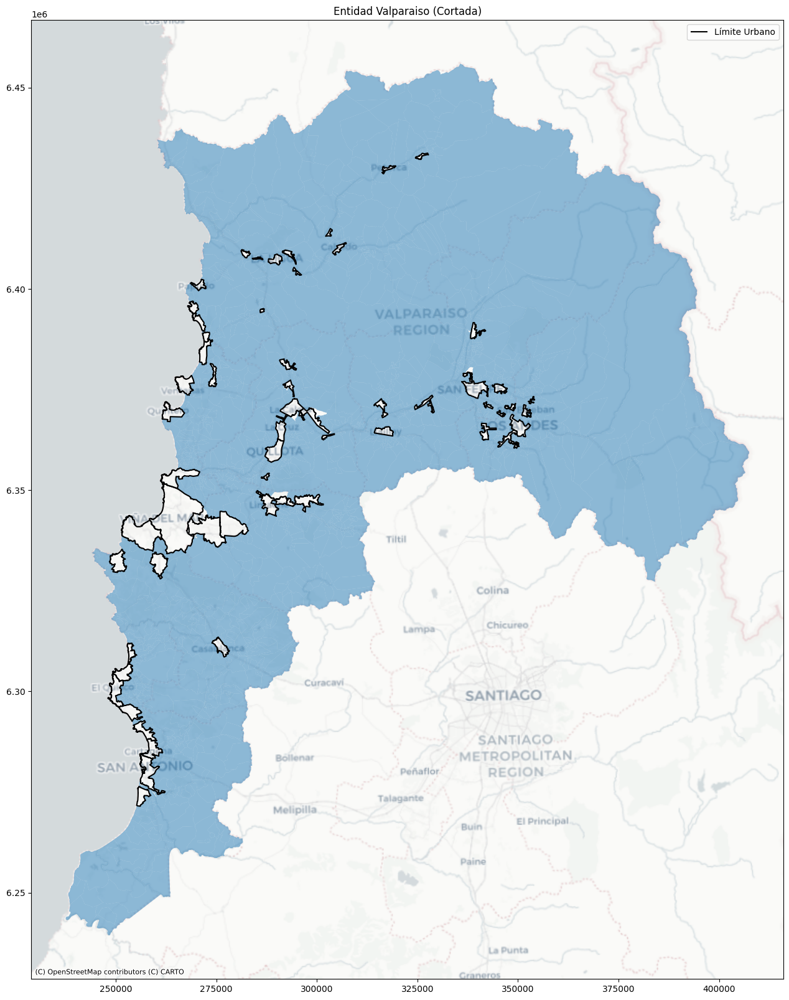

In [237]:
fig, axis = plt.subplots(figsize=(20, 20))

entidad_completa.plot(ax=axis, alpha=0.5)
limite_urbano.boundary.plot(ax=axis, label='Límite Urbano', color='black')

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.legend()
axis.set_title('Fig 5. Entidad Valparaiso (Cortada)')
plt.show()

Por el gráfico de arriba, podemos decidir en tomar todo el dataset de entidad_completa como nuestras áreas rurales pues es el complemento de los límites urbanos

In [238]:
entidad_completa

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1742,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,3,6,7,9,Parcela de Agrado,5804032006007,133,44,0.066268,0.000266,"POLYGON ((281983.072 6339023.227, 281989.166 6...",2.756986e+06
1743,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,6,7,901,15,Indeterminada,5804062007901,181,71,0.116659,0.000723,"POLYGON ((285570.796 6345102.87, 285570.971 63...",7.494385e+06
1744,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,7,8,901,15,Indeterminada,5804072008901,39,19,0.234428,0.001839,"POLYGON ((279840.683 6337426.132, 279849.156 6...",1.904590e+07
1745,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5506,NOGALES,2,7,901,15,Indeterminada,5506022007901,11,10,0.489170,0.003585,"POLYGON ((287109.546 6385150.855, 287133.087 6...",3.729538e+07


In [255]:
# APR

apr = pd.read_excel('datos_Tarea1/APR/base_ssr.xlsx', header=2)
apr = apr.drop(columns=['Unnamed: 0'])
apr = apr.loc[apr['Región']=='Valparaíso', :]

geometry_apr = gpd.points_from_xy(
    apr['Coord X WGS84'],
    apr['Coord Y WGS84 ']
)

geometry_apr

apr = gpd.GeoDataFrame(
    data=apr,
    geometry=geometry_apr,
    crs='EPSG:32719'
)
apr = apr.loc[~((apr['geometry'].x == 0) & (apr['geometry'].y == 0)), :]
apr

,N°,Región,Provincia,Comuna,Nombre oficial sistema,año puesta en marcha,N° de Arranques a diciembre 2020,Tipo,Fondos,"Beneficiarios/as Estimados a dic 2020\n 3,10 Benef/arr",...,Situación,Nombre fantasía 1,Coord X WGS84,Coord Y WGS84,Huso,Coord X WGS84 H19 Este,Coord Y WGS84 H19 norte,Coord X grados,Coord Y grados,geometry
325,279,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL EL PIMIENTO,1981.0,109.0,CONCENTRADO,BID III,338.0,...,Activo,EL PIMIENTO,351740.0,6361730.0,19.0,351740.0,6361730.0,-70.584739,-32.872541,POINT (351740 6361730)
326,314,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL LAS CALDERAS,1989.0,689.0,CONCENTRADO,BID IV,2136.0,...,Activo,LAS CALDERAS,351160.0,6360072.0,19.0,351160.0,6360072.0,-70.591203,-32.887412,POINT (351160 6360072)
327,281,Valparaíso,Los Andes,Los Andes,COMITE AGUA POTABLE RURAL EL SAUCE,1991.0,580.0,CONCENTRADO,F. MOP,1798.0,...,Activo,EL SAUCE,355460.0,6365720.0,19.0,355460.0,6365720.0,-70.544365,-32.837059,POINT (355460 6365720)
328,378,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL RIECILLO,1999.0,45.0,CONCENTRADO,ISAR MOP,140.0,...,Activo,RIECILLO,373239.0,6355995.0,19.0,373239.0,6355995.0,-70.355786,-32.926959,POINT (373239 6355995)
329,380,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL DE RIO BLANCO,1994.0,328.0,CONCENTRADO,F. MOP,1017.0,...,Activo,RÍO BLANCO,378087.0,6358009.0,19.0,378087.0,6358009.0,-70.303679,-32.909348,POINT (378087 6358009)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,275,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Renacer,2004.0,261.0,CONCENTRADO,FNDR,809.0,...,Activo,EL MIRADOR-SANTA ADELA (RENACER),266860.0,6359390.0,19.0,266860.0,6359390.0,-71.491997,-32.878852,POINT (266860 6359390)
517,351,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Mantagua,1998.0,148.0,CONCENTRADO,ISAR MOP,459.0,...,Activo,MANTAGUA,268280.0,6360690.0,19.0,268280.0,6360690.0,-71.476505,-32.867438,POINT (268280 6360690)
518,390,Valparaíso,Valparaíso,Quintero,Comite Agua Potable Rural Santa Julia,2004.0,107.0,CONCENTRADO,FNDR,332.0,...,Activo,SANTA JULIA,268415.0,6364190.0,19.0,268415.0,6364190.0,-71.474187,-32.835924,POINT (268415 6364190)
519,400,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Valle Alegre,1984.0,150.0,CONCENTRADO,BID III,465.0,...,Activo,VALLE ALEGRE,272162.0,6366995.0,19.0,272162.0,6366995.0,-71.433497,-32.811429,POINT (272162 6366995)


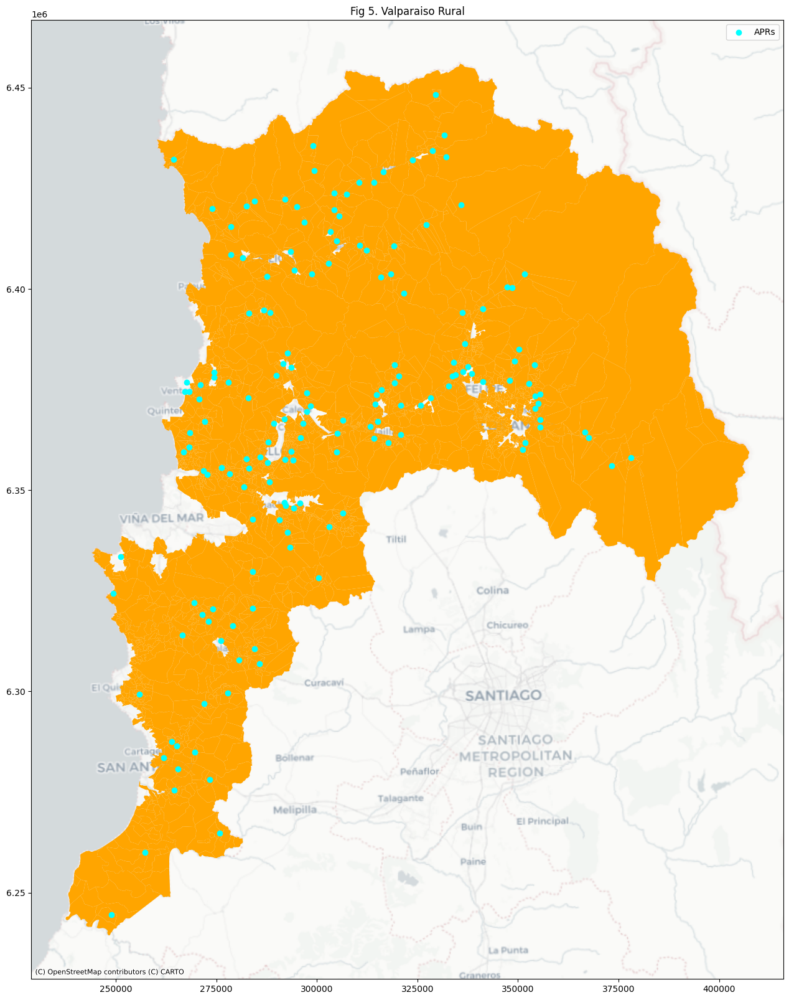

In [256]:
fig, axis = plt.subplots(figsize=(20, 20))

entidad_completa.plot(ax=axis, color='orange', lw=0.2)
apr.plot(ax=axis, label='APRs', color='aqua')

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 6. Valparaiso Rural')
axis.legend()
plt.show()

In [257]:
manz_rur_con_apr = gpd.sjoin(
    entidad_completa,
    apr[['geometry']],
    how="inner",
    predicate="intersects"
)
manz_rur_con_apr.shape

(143, 19)

C:\Users\Erick\AppData\Local\Temp\ipykernel_12932\2216692376.py:9: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  axis.legend()


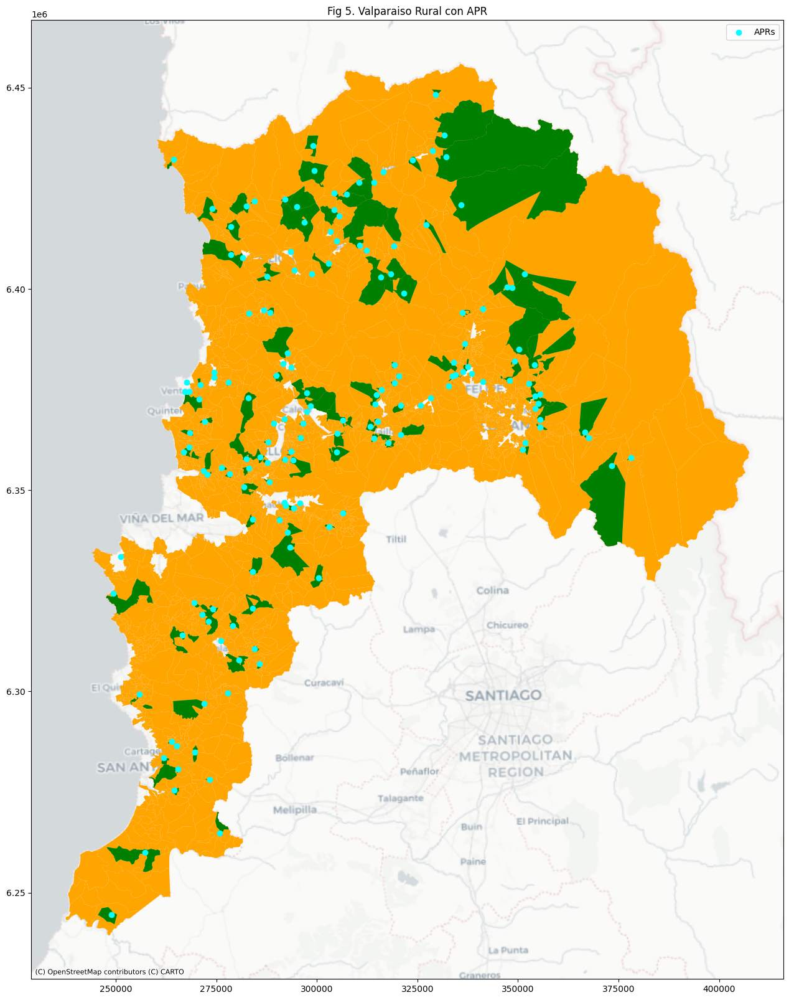

In [258]:
fig, axis = plt.subplots(figsize=(20, 20))

entidad_completa.plot(ax=axis, label='Manzanas Rurales', color='orange', lw=0.2)
manz_rur_con_apr.plot(ax=axis, label='Manzanas Rurales con APR', color='green', lw=0.2)
apr.plot(ax=axis, label='APRs', color='aqua')

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 7. Valparaiso Rural con APR')
axis.legend()
plt.show()

In [259]:
import folium

# 1) Folium SIEMPRE trabaja en EPSG:4326
entidad_ll = entidad_completa.to_crs(epsg=4326)
manz_apr_ll = manz_rur_con_apr.to_crs(epsg=4326)
apr_ll = apr.to_crs(epsg=4326)

# 2) Centro del mapa (usar la entidad completa)
centro = entidad_ll.unary_union.centroid

m = folium.Map(
    location=[centro.y, centro.x],
    tiles="CartoDB Positron",
    zoom_start=11
)

# 3) entidad_completa (naranja)
folium.GeoJson(
    entidad_ll,
    name="Manzanas Rurales",
    style_function=lambda feature: {
        "color": "orange",
        "weight": 0.8,
        "fillColor": "orange",
        "fillOpacity": 0.25
    }
).add_to(m)

# 4) manz_rur_con_apr (verde)
folium.GeoJson(
    manz_apr_ll,
    name="Manzanas Rurales con APR",
    style_function=lambda feature: {
        "color": "green",
        "weight": 1,
        "fillColor": "green",
        "fillOpacity": 0.4
    }
).add_to(m)

# 5) APR (aqua)
folium.GeoJson(
    apr_ll,
    name="APRs",
    style_function=lambda feature: {
        "color": "aqua",
        "weight": 1,
        "fillColor": "aqua",
        "fillOpacity": 0.6
    }
).add_to(m)

# 6) Control de capas (equivalente a legend)
folium.LayerControl(collapsed=False).add_to(m)

# 7) Guardar / mostrar
m.save("fig5_valparaiso_rural_apr.html")
m


C:\Users\Erick\AppData\Local\Temp\ipykernel_12932\3684779507.py:9: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centro = entidad_ll.unary_union.centroid


In [260]:
entidad_completa

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1742,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,3,6,7,9,Parcela de Agrado,5804032006007,133,44,0.066268,0.000266,"POLYGON ((281983.072 6339023.227, 281989.166 6...",2.756986e+06
1743,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,6,7,901,15,Indeterminada,5804062007901,181,71,0.116659,0.000723,"POLYGON ((285570.796 6345102.87, 285570.971 63...",7.494385e+06
1744,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,7,8,901,15,Indeterminada,5804072008901,39,19,0.234428,0.001839,"POLYGON ((279840.683 6337426.132, 279849.156 6...",1.904590e+07
1745,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5506,NOGALES,2,7,901,15,Indeterminada,5506022007901,11,10,0.489170,0.003585,"POLYGON ((287109.546 6385150.855, 287133.087 6...",3.729538e+07


In [262]:
len(entidad_completa)

1731

In [261]:
# Para hacer el calculo de la cantidad de viviendas y personas habitantes de zonas rurales con acceso deficiente a agua potable
# se va a calcular:
# 1. Cantidad de viviendas y personas en zona rurales total de Valparaiso
# 2. Cantidad de viviendas y personas en zona rurales con acceso a agua potable
# 3. La cantidad de personas/viviendas con acceso deficiente sera el resultado del punto 1 menos el resultado del punto 2

display(entidad_completa.head())

viv_rur_total = sum(entidad_completa['TOTAL_VIVI'])
per_rur_total = sum(entidad_completa['TOTAL_PERS'])

print(viv_rur_total, per_rur_total)

viv_rur_total_con_acceso = sum(manz_rur_con_apr['TOTAL_VIVI'])
per_rur_total_con_acceso = sum(manz_rur_con_apr['TOTAL_PERS'])

print(viv_rur_total_con_acceso, per_rur_total_con_acceso)


viv_rur_sin_acceso = viv_rur_total - viv_rur_total_con_acceso
per_rur_sin_acceso = per_rur_total - per_rur_total_con_acceso

print(f'Viviendas con acceso deficiente a agua potable: {viv_rur_sin_acceso}')
print(f'Personas con acceso deficiente a agua potable: {per_rur_sin_acceso}')

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06


78870 161946
14440 33124
Viviendas con acceso deficiente a agua potable: 64430
Personas con acceso deficiente a agua potable: 128822


### Respuesta

Hay un total de 78,870 viviendas en el área rural de Valparaíso y 161,946 personas.

De esos totales, 64,430 (82%) viviendas tiene un servicio deficiente de agua potable y 128,822 (79.54%) personas.

## 4.4. Para las entidades rurales sin APR, las alternativas de suministro son mediante camión aljibe o acceso directo a una fuente natural. Suponiendo que toda la población de la entidad rural se concentra en su centroide, calcule para cada una de ellas la distancia a la fuente de agua más cercana (estero, lago, laguna, río, quebrada, embalse o tranque).(2 pts)

In [264]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely
import numpy as np
import contextily as ctx

crs='3857'
crs=32719

In [293]:
# obtenemos la poblacion de la entidad rural
entidad_rural = gpd.read_file('datos_Tarea1/censo/R05/ENTIDAD_IND_C17.shp').to_crs(crs)
entidad_rural = entidad_rural.loc[entidad_rural['NOM_PROVIN']!='ISLA DE PASCUA', :]

entidad_rural = entidad_rural.loc[~(
(entidad_rural['NOM_PROVIN']=='VALPARAÍSO') &
(entidad_rural['NOM_COMUNA']=='VALPARAÍSO') &
(entidad_rural['DISTRITO']==24)), :]

entidad_rural = entidad_rural.loc[entidad_rural['NOM_COMUNA']!='JUAN FERNÁNDEZ', :]

entidad_rural_centroides = entidad_rural.centroid


entidad_rural['area'] = entidad_rural.area
print(entidad_rural.shape)
entidad_rural.head()

(1731, 18)


,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06


In [287]:
# APR

apr = pd.read_excel('datos_Tarea1/APR/base_ssr.xlsx', header=2)
apr = apr.drop(columns=['Unnamed: 0'])
apr = apr.loc[apr['Región']=='Valparaíso', :]

geometry_apr = gpd.points_from_xy(
    apr['Coord X WGS84'],
    apr['Coord Y WGS84 ']
)

geometry_apr

apr = gpd.GeoDataFrame(
    data=apr,
    geometry=geometry_apr,
    crs='EPSG:32719'
)
apr = apr.loc[~((apr['geometry'].x == 0) & (apr['geometry'].y == 0)), :]
apr

,N°,Región,Provincia,Comuna,Nombre oficial sistema,año puesta en marcha,N° de Arranques a diciembre 2020,Tipo,Fondos,"Beneficiarios/as Estimados a dic 2020\n 3,10 Benef/arr",...,Situación,Nombre fantasía 1,Coord X WGS84,Coord Y WGS84,Huso,Coord X WGS84 H19 Este,Coord Y WGS84 H19 norte,Coord X grados,Coord Y grados,geometry
325,279,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL EL PIMIENTO,1981.0,109.0,CONCENTRADO,BID III,338.0,...,Activo,EL PIMIENTO,351740.0,6361730.0,19.0,351740.0,6361730.0,-70.584739,-32.872541,POINT (351740 6361730)
326,314,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL LAS CALDERAS,1989.0,689.0,CONCENTRADO,BID IV,2136.0,...,Activo,LAS CALDERAS,351160.0,6360072.0,19.0,351160.0,6360072.0,-70.591203,-32.887412,POINT (351160 6360072)
327,281,Valparaíso,Los Andes,Los Andes,COMITE AGUA POTABLE RURAL EL SAUCE,1991.0,580.0,CONCENTRADO,F. MOP,1798.0,...,Activo,EL SAUCE,355460.0,6365720.0,19.0,355460.0,6365720.0,-70.544365,-32.837059,POINT (355460 6365720)
328,378,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL RIECILLO,1999.0,45.0,CONCENTRADO,ISAR MOP,140.0,...,Activo,RIECILLO,373239.0,6355995.0,19.0,373239.0,6355995.0,-70.355786,-32.926959,POINT (373239 6355995)
329,380,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL DE RIO BLANCO,1994.0,328.0,CONCENTRADO,F. MOP,1017.0,...,Activo,RÍO BLANCO,378087.0,6358009.0,19.0,378087.0,6358009.0,-70.303679,-32.909348,POINT (378087 6358009)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,275,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Renacer,2004.0,261.0,CONCENTRADO,FNDR,809.0,...,Activo,EL MIRADOR-SANTA ADELA (RENACER),266860.0,6359390.0,19.0,266860.0,6359390.0,-71.491997,-32.878852,POINT (266860 6359390)
517,351,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Mantagua,1998.0,148.0,CONCENTRADO,ISAR MOP,459.0,...,Activo,MANTAGUA,268280.0,6360690.0,19.0,268280.0,6360690.0,-71.476505,-32.867438,POINT (268280 6360690)
518,390,Valparaíso,Valparaíso,Quintero,Comite Agua Potable Rural Santa Julia,2004.0,107.0,CONCENTRADO,FNDR,332.0,...,Activo,SANTA JULIA,268415.0,6364190.0,19.0,268415.0,6364190.0,-71.474187,-32.835924,POINT (268415 6364190)
519,400,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Valle Alegre,1984.0,150.0,CONCENTRADO,BID III,465.0,...,Activo,VALLE ALEGRE,272162.0,6366995.0,19.0,272162.0,6366995.0,-71.433497,-32.811429,POINT (272162 6366995)


In [328]:
agua = gpd.read_file('datos_Tarea1/hidrografia/hidrografiaChile.gpkg', encoding='utf-8').to_crs(crs)

agua_rural = agua.clip(entidad_rural)
agua_rural

,id,nombre,tipo,escala,nivel,sourcethm,length,geometry
101923,26,Rio Rapel,RÃ­o,Regional,1,Drenes_06.shp,5890.302,"MULTILINESTRING ((247309.69 6241081.125, 24733..."
105924,999,Rio Rapel,RÃ­o,Regional,1,Drenes_05.shp,5890.302,"MULTILINESTRING ((247309.69 6241081.125, 24733..."
103488,1695,Rio Rapel,RÃ­o,Regional,1,Drenes_06.shp,3844.996,"MULTILINESTRING ((249068.25 6240222.754, 24906..."
109545,4639,None,Estero,Local,3,Drenes_05.shp,3843.826,"MULTILINESTRING ((249150.996 6240489.487, 2491..."
33765,3662,None,Estero,Local,3,Drenes_13.shp,3843.826,"MULTILINESTRING ((249150.996 6240489.487, 2491..."
...,...,...,...,...,...,...,...,...
105992,1074,Quebrada El Penon,Quebrada,Local,3,Drenes_05.shp,1810.820,"LINESTRING (313097.312 6447041, 313219.125 644..."
105988,1070,None,Quebrada,Local,3,Drenes_05.shp,1265.024,"LINESTRING (316423.531 6447126, 316169.801 644..."
105991,1073,Quebrada La Candelaria,Quebrada,Local,3,Drenes_05.shp,1566.318,"LINESTRING (314201.219 6447884.5, 314208.906 6..."
105987,1069,Quebrada Las Raices,Quebrada,Local,3,Drenes_05.shp,5265.073,"LINESTRING (316604.777 6451253.656, 316520.11 ..."


In [329]:
agua.shape

(128367, 8)

In [332]:
# obteniendo entidades rurales sin presencia de APR
ent_rur_sin_apr = gpd.sjoin(
    entidad_rural,
    apr[['geometry']],
    how="left",
    predicate="intersects"
)
ent_rur_sin_apr = ent_rur_sin_apr.loc[ent_rur_sin_apr['index_right'].isna(), :]
ent_rur_sin_apr_centroides = ent_rur_sin_apr.centroid
display(ent_rur_sin_apr.head())
ent_rur_sin_apr.shape

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area,index_right
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05,NaN
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06,NaN
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07,NaN
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05,NaN
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06,NaN


(1588, 19)

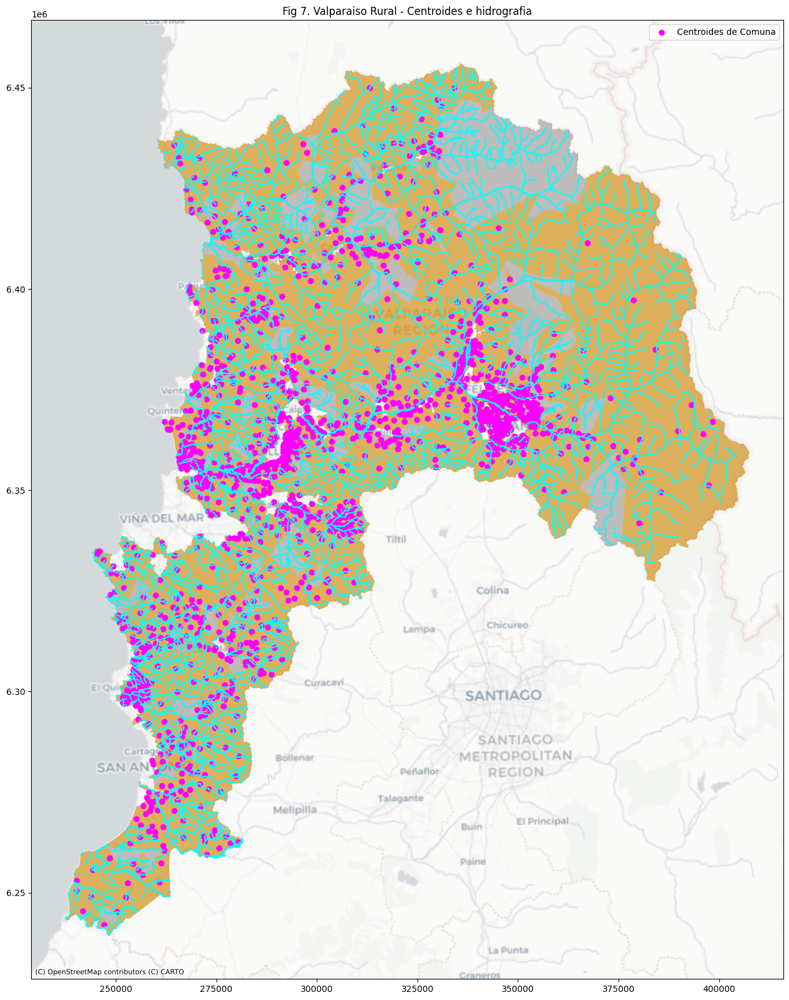

In [333]:
fig, axis = plt.subplots(figsize=(20, 20))

entidad_rural.plot(ax=axis, color='gray', alpha=0.5)
ent_rur_sin_apr.plot(ax=axis, color='orange', alpha=0.5, lw=0.2)
ent_rur_sin_apr_centroides.plot(ax=axis, label='Centroides de Comuna', color='magenta')
agua_rural.plot(ax=axis, color='aqua')

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 7. Valparaiso Rural - Centroides e hidrografia')
axis.legend()
plt.show()

In [339]:
agua_rural

,id,nombre,tipo,escala,nivel,sourcethm,length,geometry
101923,26,Rio Rapel,RÃ­o,Regional,1,Drenes_06.shp,5890.302,"MULTILINESTRING ((247309.69 6241081.125, 24733..."
105924,999,Rio Rapel,RÃ­o,Regional,1,Drenes_05.shp,5890.302,"MULTILINESTRING ((247309.69 6241081.125, 24733..."
103488,1695,Rio Rapel,RÃ­o,Regional,1,Drenes_06.shp,3844.996,"MULTILINESTRING ((249068.25 6240222.754, 24906..."
109545,4639,None,Estero,Local,3,Drenes_05.shp,3843.826,"MULTILINESTRING ((249150.996 6240489.487, 2491..."
33765,3662,None,Estero,Local,3,Drenes_13.shp,3843.826,"MULTILINESTRING ((249150.996 6240489.487, 2491..."
...,...,...,...,...,...,...,...,...
105992,1074,Quebrada El Penon,Quebrada,Local,3,Drenes_05.shp,1810.820,"LINESTRING (313097.312 6447041, 313219.125 644..."
105988,1070,None,Quebrada,Local,3,Drenes_05.shp,1265.024,"LINESTRING (316423.531 6447126, 316169.801 644..."
105991,1073,Quebrada La Candelaria,Quebrada,Local,3,Drenes_05.shp,1566.318,"LINESTRING (314201.219 6447884.5, 314208.906 6..."
105987,1069,Quebrada Las Raices,Quebrada,Local,3,Drenes_05.shp,5265.073,"LINESTRING (316604.777 6451253.656, 316520.11 ..."


In [342]:
centroides_gdf

,geometry
0,POINT (354471.086 6366446.831)
1,POINT (354313.1 6364059.149)
2,POINT (360602.607 6359159.586)
3,POINT (357366.9 6364270.722)
4,POINT (367429.689 6360881.514)
...,...
1742,POINT (282093.086 6337881.644)
1743,POINT (285334.1 6343074.625)
1744,POINT (283291.124 6335232.643)
1745,POINT (286470.296 6380461.634)


In [343]:
centroides_gdf = gpd.GeoDataFrame(geometry=ent_rur_sin_apr_centroides, crs=crs)

cuerpo_agua_mas_cercano = gpd.sjoin_nearest(
    left_df=centroides_gdf,
    right_df=agua_rural[["tipo", "geometry"]],
    how="left",
    distance_col="dist_m"
).groupby('geometry')['dist_m'].agg('min')
cuerpo_agua_mas_cercano

geometry
POINT (241733.795 6245431.253)    1139.358252
POINT (240231.999 6250339.923)     109.715658
POINT (240208.992 6253016.9)       604.399550
POINT (243790.689 6249000.301)      77.390744
POINT (247093.471 6242061.856)     659.750156
                                     ...     
POINT (393171.14 6371176.118)      654.229284
POINT (398405.524 6367088.487)     777.585243
POINT (396084.793 6363921.336)    1302.983651
POINT (397402.925 6351303.365)     285.513084
POINT (380111.024 6341824.129)     833.719435
Name: dist_m, Length: 1588, dtype: float64

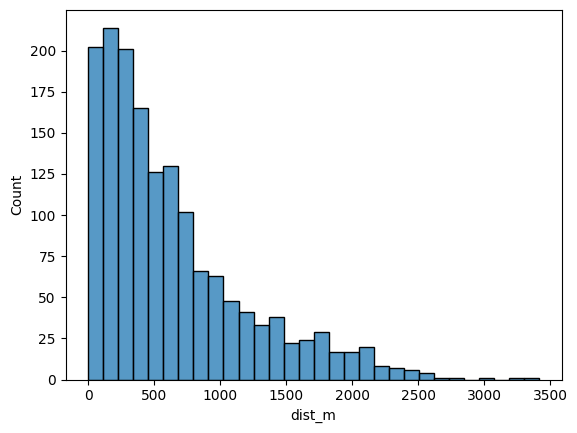

In [345]:
fig, axis = plt.subplots()

sns.histplot(cuerpo_agua_mas_cercano, ax=axis)

plt.show()

In [346]:
cuerpo_agua_mas_cercano.describe()

count    1588.000000
mean      639.688343
std       566.194090
min         0.803438
25%       214.139351
50%       469.158529
75%       886.037474
max      3417.665335
Name: dist_m, dtype: float64

### Respuesta

Para las zonas sin acceso a APR, se cuenta con una distancia promedio de 639 metros hacia diferentes cuerpos de agua, con una mediana de 469 metros. 

## 4.5. Suponga que una persona habitante de zona rural sin APR puede trasladarse un máximo de 1 km para ir a buscar agua, y de encontrarse a una distancia mayor de 1km, debe ser abastecido con camión aljibe. ¿A cuántas personas habría que abastecer mediante camión aljibe?(1 pt)


In [349]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely
import numpy as np
import contextily as ctx

crs='3857'
crs=32719

In [347]:
# obtenemos la poblacion de la entidad rural
entidad_rural = gpd.read_file('datos_Tarea1/censo/R05/ENTIDAD_IND_C17.shp').to_crs(crs)
entidad_rural = entidad_rural.loc[entidad_rural['NOM_PROVIN']!='ISLA DE PASCUA', :]

entidad_rural = entidad_rural.loc[~(
(entidad_rural['NOM_PROVIN']=='VALPARAÍSO') &
(entidad_rural['NOM_COMUNA']=='VALPARAÍSO') &
(entidad_rural['DISTRITO']==24)), :]

entidad_rural = entidad_rural.loc[entidad_rural['NOM_COMUNA']!='JUAN FERNÁNDEZ', :]

entidad_rural_centroides = entidad_rural.centroid


entidad_rural['area'] = entidad_rural.area
print(entidad_rural.shape)
entidad_rural.head()

(1731, 18)


,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06


In [348]:
# APR

apr = pd.read_excel('datos_Tarea1/APR/base_ssr.xlsx', header=2)
apr = apr.drop(columns=['Unnamed: 0'])
apr = apr.loc[apr['Región']=='Valparaíso', :]

geometry_apr = gpd.points_from_xy(
    apr['Coord X WGS84'],
    apr['Coord Y WGS84 ']
)

geometry_apr

apr = gpd.GeoDataFrame(
    data=apr,
    geometry=geometry_apr,
    crs='EPSG:32719'
)
apr = apr.loc[~((apr['geometry'].x == 0) & (apr['geometry'].y == 0)), :]
apr

,N°,Región,Provincia,Comuna,Nombre oficial sistema,año puesta en marcha,N° de Arranques a diciembre 2020,Tipo,Fondos,"Beneficiarios/as Estimados a dic 2020\n 3,10 Benef/arr",...,Situación,Nombre fantasía 1,Coord X WGS84,Coord Y WGS84,Huso,Coord X WGS84 H19 Este,Coord Y WGS84 H19 norte,Coord X grados,Coord Y grados,geometry
325,279,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL EL PIMIENTO,1981.0,109.0,CONCENTRADO,BID III,338.0,...,Activo,EL PIMIENTO,351740.0,6361730.0,19.0,351740.0,6361730.0,-70.584739,-32.872541,POINT (351740 6361730)
326,314,Valparaíso,Los Andes,Calle Larga,COMITE AGUA POTABLE RURAL LAS CALDERAS,1989.0,689.0,CONCENTRADO,BID IV,2136.0,...,Activo,LAS CALDERAS,351160.0,6360072.0,19.0,351160.0,6360072.0,-70.591203,-32.887412,POINT (351160 6360072)
327,281,Valparaíso,Los Andes,Los Andes,COMITE AGUA POTABLE RURAL EL SAUCE,1991.0,580.0,CONCENTRADO,F. MOP,1798.0,...,Activo,EL SAUCE,355460.0,6365720.0,19.0,355460.0,6365720.0,-70.544365,-32.837059,POINT (355460 6365720)
328,378,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL RIECILLO,1999.0,45.0,CONCENTRADO,ISAR MOP,140.0,...,Activo,RIECILLO,373239.0,6355995.0,19.0,373239.0,6355995.0,-70.355786,-32.926959,POINT (373239 6355995)
329,380,Valparaíso,Los Andes,Los Andes,COMITE DE AGUA POTABLE RURAL DE RIO BLANCO,1994.0,328.0,CONCENTRADO,F. MOP,1017.0,...,Activo,RÍO BLANCO,378087.0,6358009.0,19.0,378087.0,6358009.0,-70.303679,-32.909348,POINT (378087 6358009)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,275,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Renacer,2004.0,261.0,CONCENTRADO,FNDR,809.0,...,Activo,EL MIRADOR-SANTA ADELA (RENACER),266860.0,6359390.0,19.0,266860.0,6359390.0,-71.491997,-32.878852,POINT (266860 6359390)
517,351,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Mantagua,1998.0,148.0,CONCENTRADO,ISAR MOP,459.0,...,Activo,MANTAGUA,268280.0,6360690.0,19.0,268280.0,6360690.0,-71.476505,-32.867438,POINT (268280 6360690)
518,390,Valparaíso,Valparaíso,Quintero,Comite Agua Potable Rural Santa Julia,2004.0,107.0,CONCENTRADO,FNDR,332.0,...,Activo,SANTA JULIA,268415.0,6364190.0,19.0,268415.0,6364190.0,-71.474187,-32.835924,POINT (268415 6364190)
519,400,Valparaíso,Valparaíso,Quintero,Comite De Agua Potable Rural Valle Alegre,1984.0,150.0,CONCENTRADO,BID III,465.0,...,Activo,VALLE ALEGRE,272162.0,6366995.0,19.0,272162.0,6366995.0,-71.433497,-32.811429,POINT (272162 6366995)


In [350]:
agua = gpd.read_file('datos_Tarea1/hidrografia/hidrografiaChile.gpkg', encoding='utf-8').to_crs(crs)

agua_rural = agua.clip(entidad_rural)
agua_rural

,id,nombre,tipo,escala,nivel,sourcethm,length,geometry
101923,26,Rio Rapel,RÃ­o,Regional,1,Drenes_06.shp,5890.302,"MULTILINESTRING ((247309.69 6241081.125, 24733..."
105924,999,Rio Rapel,RÃ­o,Regional,1,Drenes_05.shp,5890.302,"MULTILINESTRING ((247309.69 6241081.125, 24733..."
103488,1695,Rio Rapel,RÃ­o,Regional,1,Drenes_06.shp,3844.996,"MULTILINESTRING ((249068.25 6240222.754, 24906..."
109545,4639,None,Estero,Local,3,Drenes_05.shp,3843.826,"MULTILINESTRING ((249150.996 6240489.487, 2491..."
33765,3662,None,Estero,Local,3,Drenes_13.shp,3843.826,"MULTILINESTRING ((249150.996 6240489.487, 2491..."
...,...,...,...,...,...,...,...,...
105992,1074,Quebrada El Penon,Quebrada,Local,3,Drenes_05.shp,1810.820,"LINESTRING (313097.312 6447041, 313219.125 644..."
105988,1070,None,Quebrada,Local,3,Drenes_05.shp,1265.024,"LINESTRING (316423.531 6447126, 316169.801 644..."
105991,1073,Quebrada La Candelaria,Quebrada,Local,3,Drenes_05.shp,1566.318,"LINESTRING (314201.219 6447884.5, 314208.906 6..."
105987,1069,Quebrada Las Raices,Quebrada,Local,3,Drenes_05.shp,5265.073,"LINESTRING (316604.777 6451253.656, 316520.11 ..."


In [352]:
agua_rural['tipo'].value_counts()

tipo
Quebrada    2373
RÃ­o         763
Estero       761
Laguna       263
Embalse       93
Costa         43
Lago           6
Tranque        1
Ficticia       1
Name: count, dtype: int64

In [351]:
# obteniendo entidades rurales sin presencia de APR
ent_rur_sin_apr = gpd.sjoin(
    entidad_rural,
    apr[['geometry']],
    how="left",
    predicate="intersects"
)
ent_rur_sin_apr = ent_rur_sin_apr.loc[ent_rur_sin_apr['index_right'].isna(), :]
ent_rur_sin_apr_centroides = ent_rur_sin_apr.centroid
display(ent_rur_sin_apr.head())
ent_rur_sin_apr.shape

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area,index_right
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05,NaN
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06,NaN
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07,NaN
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05,NaN
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06,NaN


(1588, 19)

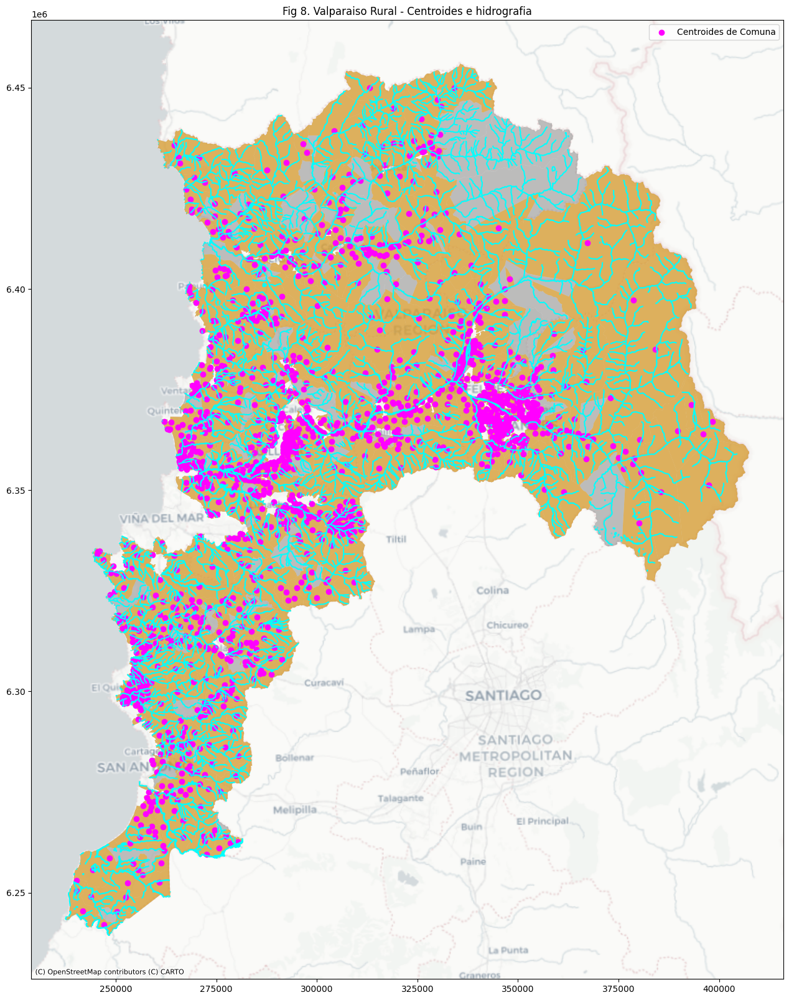

In [353]:
fig, axis = plt.subplots(figsize=(20, 20))

entidad_rural.plot(ax=axis, color='gray', alpha=0.5)
ent_rur_sin_apr.plot(ax=axis, color='orange', alpha=0.5, lw=0.2)
ent_rur_sin_apr_centroides.plot(ax=axis, label='Centroides de Comuna', color='magenta')
agua_rural.plot(ax=axis, color='aqua')

ctx.add_basemap(ax=axis, source=ctx.providers.CartoDB.Positron,crs=crs)
axis.set_title('Fig 8. Valparaiso Rural - Centroides e hidrografia')
axis.legend()
plt.show()

In [369]:
centroides_gdf = gpd.GeoDataFrame(geometry=ent_rur_sin_apr_centroides, crs=crs)

cuerpo_agua_mas_cercano = gpd.sjoin_nearest(
    left_df=centroides_gdf,
    right_df=agua_rural[["tipo", "geometry"]],
    how="left",
    distance_col="dist_m"
).groupby('geometry')['dist_m'].agg('min').reset_index()
cuerpo_agua_mas_cercano = gpd.GeoDataFrame(data=cuerpo_agua_mas_cercano, geometry='geometry', crs=32719)
cuerpo_agua_mas_cercano

,geometry,dist_m
0,POINT (241733.795 6245431.253),1139.358252
1,POINT (240231.999 6250339.923),109.715658
2,POINT (240208.992 6253016.9),604.399550
3,POINT (243790.689 6249000.301),77.390744
4,POINT (247093.471 6242061.856),659.750156
...,...,...
1583,POINT (393171.14 6371176.118),654.229284
1584,POINT (398405.524 6367088.487),777.585243
1585,POINT (396084.793 6363921.336),1302.983651
1586,POINT (397402.925 6351303.365),285.513084


In [372]:
ent_rur_sin_apr

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,DISTRITO,LOC_ZON,ENT_MAN,CATEGORIA,NOM_CATEGO,MANZENT_I,TOTAL_PERS,TOTAL_VIVI,SHAPE_Leng,SHAPE_Area,geometry,area,index_right
0,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,10,4,Caserío,5301042003010,55,19,0.024775,0.000028,"POLYGON ((354569.953 6366240.367, 354591.89 63...",2.890657e+05,NaN
1,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,11,7,Fundo-Estancia-Hacienda,5301042003011,25,10,0.119382,0.000591,"POLYGON ((354756.34 6365585.976, 355019.825 63...",6.138624e+06,NaN
2,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,3,15,8,Parcela-Hijuela,5301042003015,19,10,0.354050,0.002236,"POLYGON ((361620.407 6363618.979, 361546.073 6...",2.319519e+07,NaN
3,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,5,21,8,Parcela-Hijuela,5301042005021,28,11,0.047816,0.000082,"POLYGON ((357503.689 6364883.783, 357531.821 6...",8.508459e+05,NaN
4,5,REGIÓN DE VALPARAÍSO,53,LOS ANDES,5301,LOS ANDES,4,12,45,4,Caserío,5301042012045,13,5,0.123907,0.000347,"POLYGON ((367920.53 6362822.545, 367949.322 63...",3.604278e+06,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1742,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,3,6,7,9,Parcela de Agrado,5804032006007,133,44,0.066268,0.000266,"POLYGON ((281983.072 6339023.227, 281989.166 6...",2.756986e+06,NaN
1743,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,6,7,901,15,Indeterminada,5804062007901,181,71,0.116659,0.000723,"POLYGON ((285570.796 6345102.87, 285570.971 63...",7.494385e+06,NaN
1744,5,REGIÓN DE VALPARAÍSO,58,MARGA MARGA,5804,VILLA ALEMANA,7,8,901,15,Indeterminada,5804072008901,39,19,0.234428,0.001839,"POLYGON ((279840.683 6337426.132, 279849.156 6...",1.904590e+07,NaN
1745,5,REGIÓN DE VALPARAÍSO,55,QUILLOTA,5506,NOGALES,2,7,901,15,Indeterminada,5506022007901,11,10,0.489170,0.003585,"POLYGON ((287109.546 6385150.855, 287133.087 6...",3.729538e+07,NaN


In [384]:
distancia_por_area = gpd.sjoin(
    left_df=ent_rur_sin_apr.drop('index_right', axis=1),
    right_df=cuerpo_agua_mas_cercano,
    how='left',
    predicate='contains'
)
distancia_por_area['flag_mas_1km'] = distancia_por_area['dist_m'].apply(lambda x: 1 if x>1000 else 0)

In [387]:
distancia_por_area.groupby('flag_mas_1km')['TOTAL_PERS'].sum()

flag_mas_1km
0    105762
1     30069
Name: TOTAL_PERS, dtype: int32

In [388]:
distancia_por_area.groupby('flag_mas_1km')['TOTAL_PERS'].sum().sum()

np.int64(135831)

In [389]:
distancia_por_area.groupby('flag_mas_1km')['TOTAL_VIVI'].sum()

flag_mas_1km
0    54895
1    12939
Name: TOTAL_VIVI, dtype: int32

In [390]:
distancia_por_area.groupby('flag_mas_1km')['TOTAL_VIVI'].sum().sum()

np.int64(67834)

### Respuesta
De los 135,831 habitantes de la zona rural sin acceso a un APR, 30,069 viven a una distancia mayor de 1 kilómetro de un cuerpo de agua, por lo que necesitarán ser abastecidos con camión aljibe

## 4.6. Genere un mapa con la ubicación de las entidades rurales que requieren suministro mediante camión aljibe, y la cantidad de personas a abastecer en cada una de ellas (como escala de colores).(2 pts)

### Respuesta

C:\Users\Erick\AppData\Local\Temp\ipykernel_12932\2657455639.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend(loc="lower left")


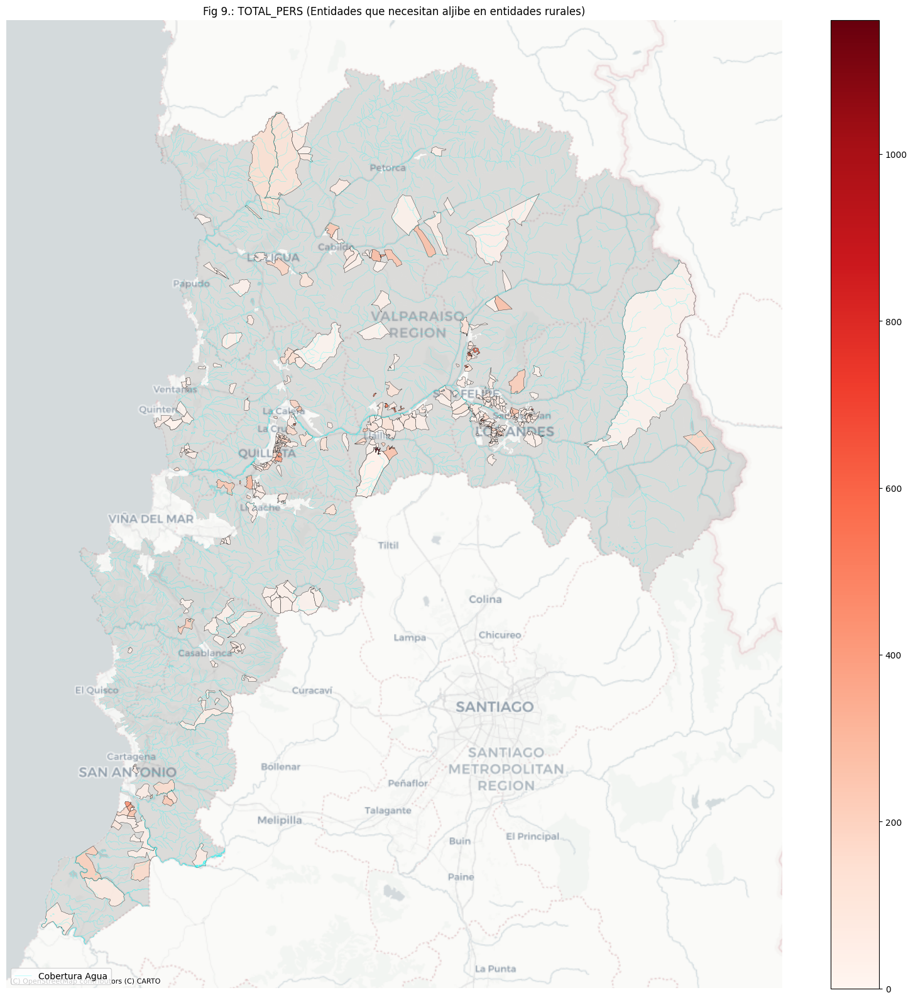

In [406]:
import matplotlib.pyplot as plt
import contextily as ctx


entidad_rural_wm = entidad_rural.to_crs(epsg=3857)
entidades_nec_wm = entidades_necesitan_aljibe.to_crs(epsg=3857)
agua_rural_wm = agua_rural.to_crs(epsg=3857)

fig, ax = plt.subplots(figsize=(20, 20))


entidad_rural_wm.plot(
    ax=ax, color="gray", alpha=0.25, edgecolor="none", label="Área Rural Completa"
)


agua_rural_wm.plot(
    ax=ax, color="aqua", alpha=0.35, edgecolor="aqua", linewidth=0.5, label="Cobertura Agua"
)

entidades_nec_wm.plot(
    ax=ax,
    column="TOTAL_PERS",
    cmap="Reds",
    legend=True,
    edgecolor="black",
    linewidth=0.3,
    alpha=0.85,
    missing_kwds={
        "color": "lightgrey",
        "edgecolor": "black",
        "hatch": "///",
        "label": "Sin dato"
    }
)


ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

ax.set_title("Fig 9.: TOTAL_PERS (Entidades que necesitan aljibe en entidades rurales)")
ax.set_axis_off()


ax.legend(loc="lower left")
plt.show()
